In [45]:
"""
1. read in sample collection csv
2. get request to link
3. add parameter to be ?fo=json to end of request
4. go down tree to [item][image_url][1]
5. download and detect image
"""

'\n1. read in sample collection csv\n2. get request to link\n3. add parameter to be ?fo=json to end of request\n4. go down tree to [item][image_url][1]\n5. download and detect image\n'

In [46]:
import requests
import csv
import os, os.path
from PIL import Image
from io import BytesIO

In [57]:
# image detection imports
from torchvision.io.image import read_image

# Explore the torchvision documentation to apply the other models and their weights
from torchvision.models.detection import (
    fasterrcnn_resnet50_fpn_v2,
    FasterRCNN_ResNet50_FPN_V2_Weights,
)
from torchvision.utils import draw_bounding_boxes
from torchvision.transforms.functional import to_pil_image
from IPython.display import display

In [47]:
file = "./jfp-collections-sample-collection.csv"

In [48]:
"""Read in csv"""

item_links = []

with open(file, 'r') as links:
        item = csv.reader(links)
        for item_row_data in item:
            item_links.append(item_row_data)

In [49]:
"""Testing fields and appending links alone"""
links = []

for x in item_links[1:]:
    links.append(x[2])
    # print(x)
for y in links:
    print(y)


https://www.loc.gov/resource/ppmsca.51533/
https://www.loc.gov/resource/ppmsca.01947/
https://www.loc.gov/resource/ppmsca.41718/
https://www.loc.gov/resource/hec.20723/
https://www.loc.gov/resource/ds.00753/
https://www.loc.gov/resource/fsa.8d42580/
https://www.loc.gov/resource/fsa.8c03380/
https://www.loc.gov/resource/highsm.12500/
https://www.loc.gov/resource/ppss.00845/
https://www.loc.gov/resource/ppmsca.18016/
https://www.loc.gov/resource/g3851a.pm001100/
https://www.loc.gov/resource/hec.33721/
https://www.loc.gov/item/2016828540/
https://www.loc.gov/item/2022643224/
https://www.loc.gov/item/mnwp000080/
https://www.loc.gov/item/mnwp000193/
https://www.loc.gov/item/2003689093/
https://www.loc.gov/item/2002708615/
https://www.loc.gov/item/2017828946/
https://www.loc.gov/item/2007684227/
https://www.loc.gov/resource/npcc.01504/
https://www.loc.gov/item/2016891734/
https://www.loc.gov/resource/highsm.16055/
https://www.loc.gov/resource/highsm.15040/
https://www.loc.gov/resource/highsm

In [50]:
"""Set up base endpoint and loop through"""

image_list = []
error_links = []

for indv_link in links:
    try:
        get_image = requests.get(indv_link + '?fo=json')
        response = get_image.json()
        actual_im_link = response['item']['image_url'][2]
    # image_list.append(actual_im_link)
    # print(actual_im_link)
        # print(actual_im_link)
        image_list.append(actual_im_link)
    except:
        # print(response['item'])
        error_links.append(response['item'])
    # break

In [51]:
for x in error_links:
    print(x)

In [52]:
for x in image_list:
    print(x)

https://tile.loc.gov/storage-services/service/pnp/ppmsca/51500/51533v.jpg#h=1024&w=801
https://tile.loc.gov/storage-services/service/pnp/ppmsca/01900/01947r.jpg#h=640&w=594
https://tile.loc.gov/storage-services/service/pnp/ppmsca/41700/41718v.jpg#h=735&w=1024
https://tile.loc.gov/storage-services/service/pnp/hec/20700/20723r.jpg#h=511&w=640
https://tile.loc.gov/storage-services/service/pnp/ds/00700/00753v.jpg#h=1024&w=676
https://tile.loc.gov/storage-services/service/pnp/fsa/8d42000/8d42500/8d42580r.jpg#h=509&w=640
https://tile.loc.gov/storage-services/service/pnp/fsa/8c03000/8c03300/8c03380r.jpg#h=494&w=640
https://tile.loc.gov/image-services/iiif/service:pnp:highsm:12500:12500/full/pct:25/0/default.jpg#h=1225&w=1541
https://tile.loc.gov/storage-services/service/pnp/ppmsca/57300/57374v.jpg#h=1024&w=855
https://tile.loc.gov/storage-services/service/pnp/ppmsca/18000/18016r.jpg#h=472&w=640
https://tile.loc.gov/image-services/iiif/service:gmd:gmd385:g3851:g3851a:pm001100/full/pct:12.5/0/d

In [53]:
os.mkdir('faster-rcnn-test-images')

In [56]:
for index, image in enumerate(image_list): #what does enumerate do? index here helps to increment the file names.
        try:
                print(image)
                image_to_detect = requests.get(image)
                image_filename = f"faster-rcnn-test-images/image_{index + 1}.jpg"
                img_bytes_io = BytesIO(image_to_detect.content)
                converted_file = Image.open(img_bytes_io).convert('RGB').save(image_filename)
        except:
                print(image)

https://tile.loc.gov/storage-services/service/pnp/ppmsca/51500/51533v.jpg#h=1024&w=801
https://tile.loc.gov/storage-services/service/pnp/ppmsca/01900/01947r.jpg#h=640&w=594
https://tile.loc.gov/storage-services/service/pnp/ppmsca/41700/41718v.jpg#h=735&w=1024
https://tile.loc.gov/storage-services/service/pnp/hec/20700/20723r.jpg#h=511&w=640
https://tile.loc.gov/storage-services/service/pnp/ds/00700/00753v.jpg#h=1024&w=676
https://tile.loc.gov/storage-services/service/pnp/fsa/8d42000/8d42500/8d42580r.jpg#h=509&w=640
https://tile.loc.gov/storage-services/service/pnp/fsa/8c03000/8c03300/8c03380r.jpg#h=494&w=640
https://tile.loc.gov/image-services/iiif/service:pnp:highsm:12500:12500/full/pct:25/0/default.jpg#h=1225&w=1541
https://tile.loc.gov/image-services/iiif/service:pnp:highsm:12500:12500/full/pct:25/0/default.jpg#h=1225&w=1541
https://tile.loc.gov/storage-services/service/pnp/ppmsca/57300/57374v.jpg#h=1024&w=855
https://tile.loc.gov/storage-services/service/pnp/ppmsca/18000/18016r.jpg

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


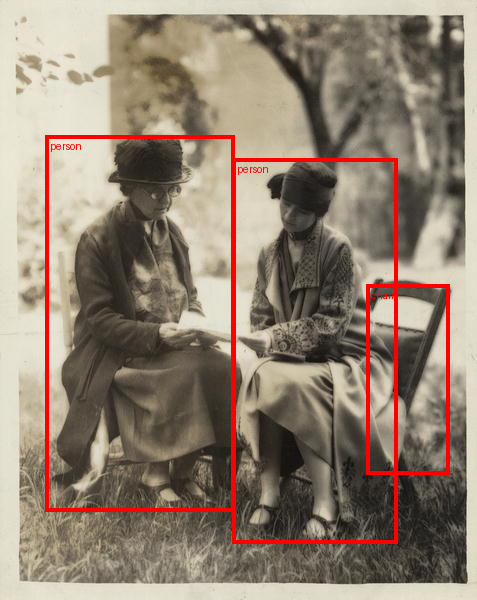

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


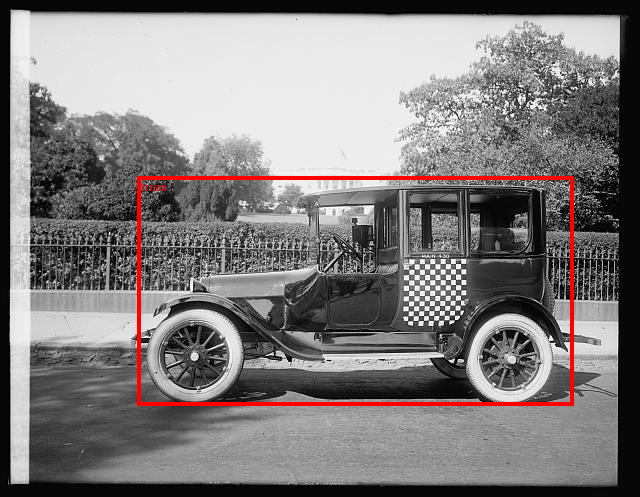

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


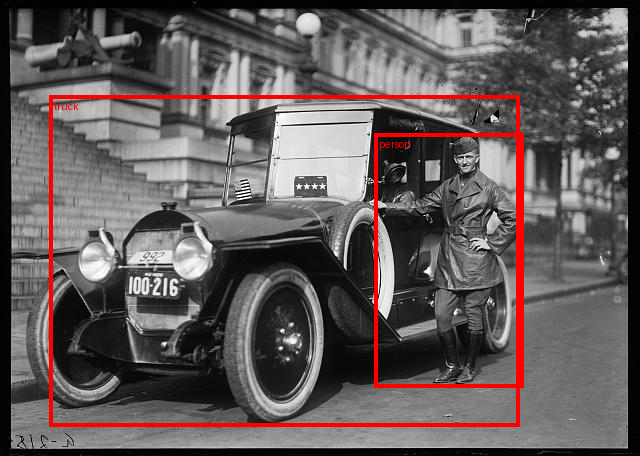

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


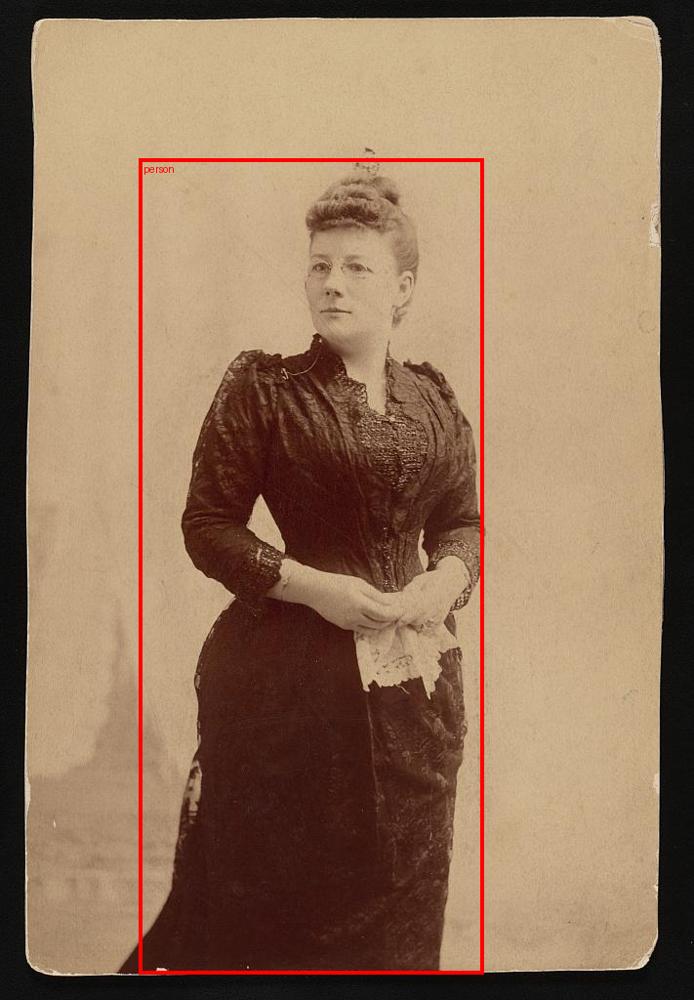

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


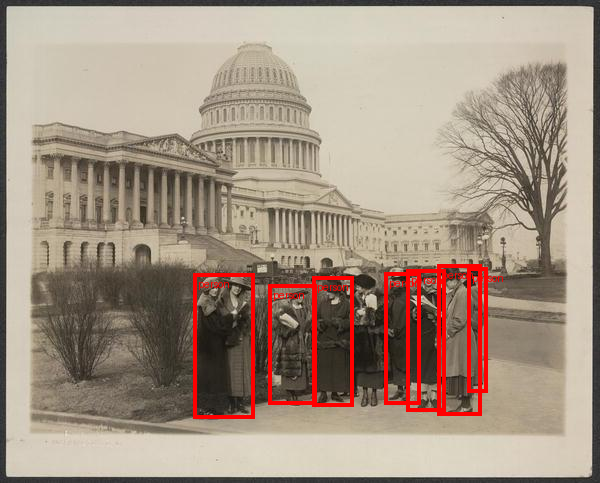

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


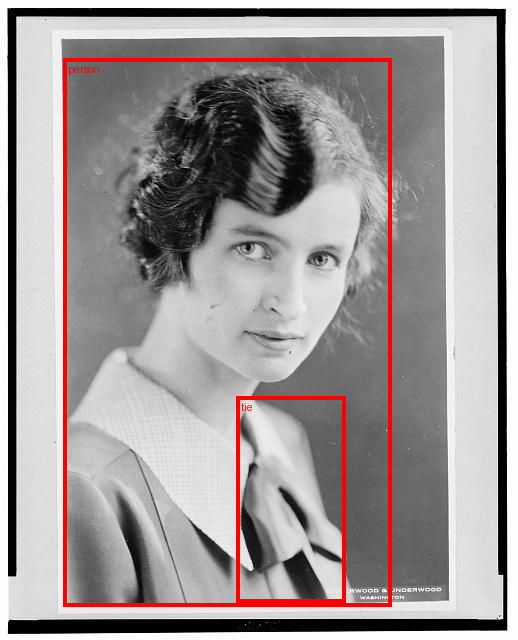

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


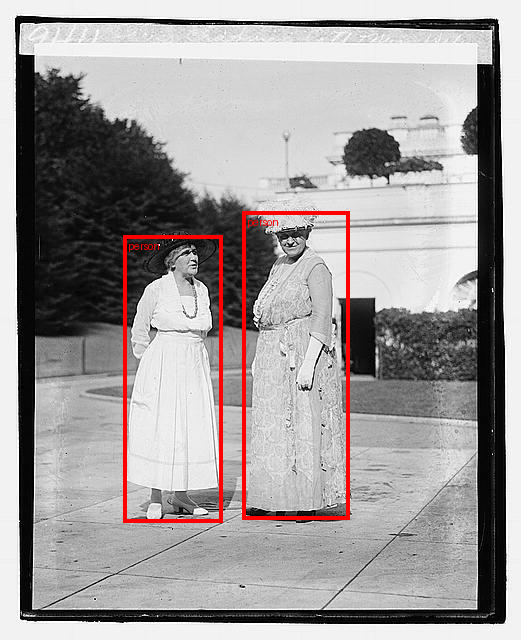

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


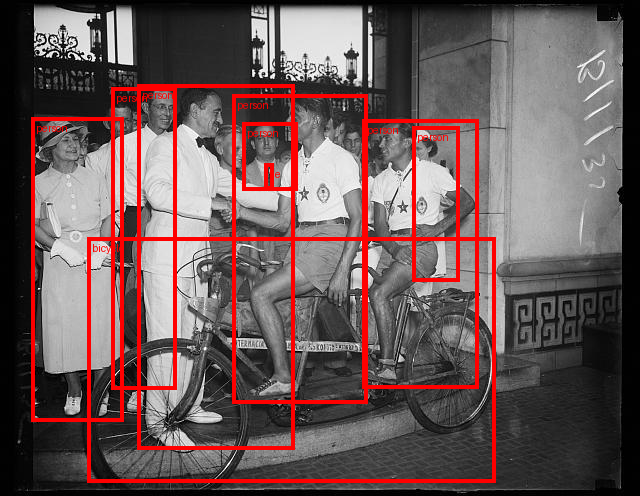

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


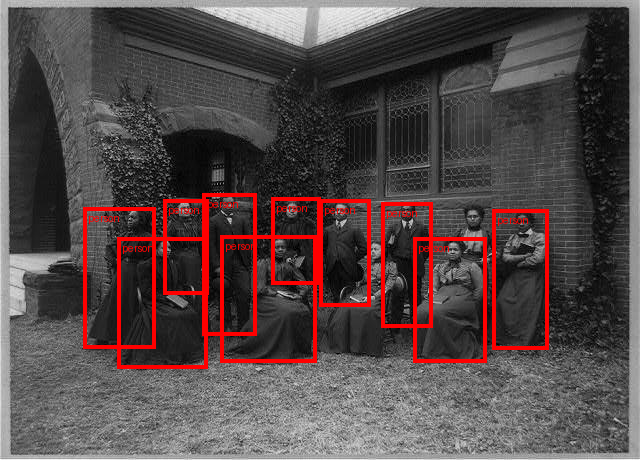

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


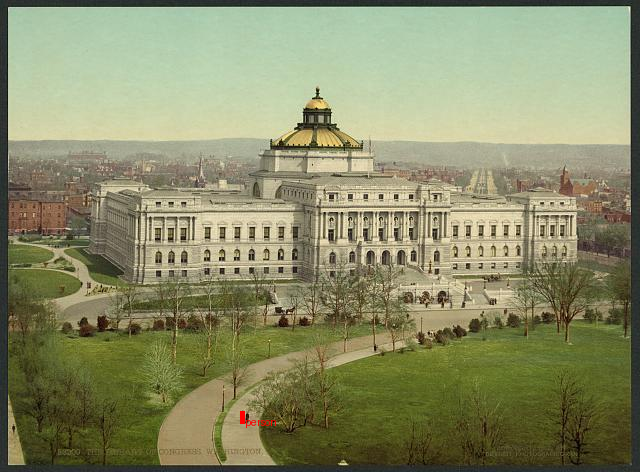

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


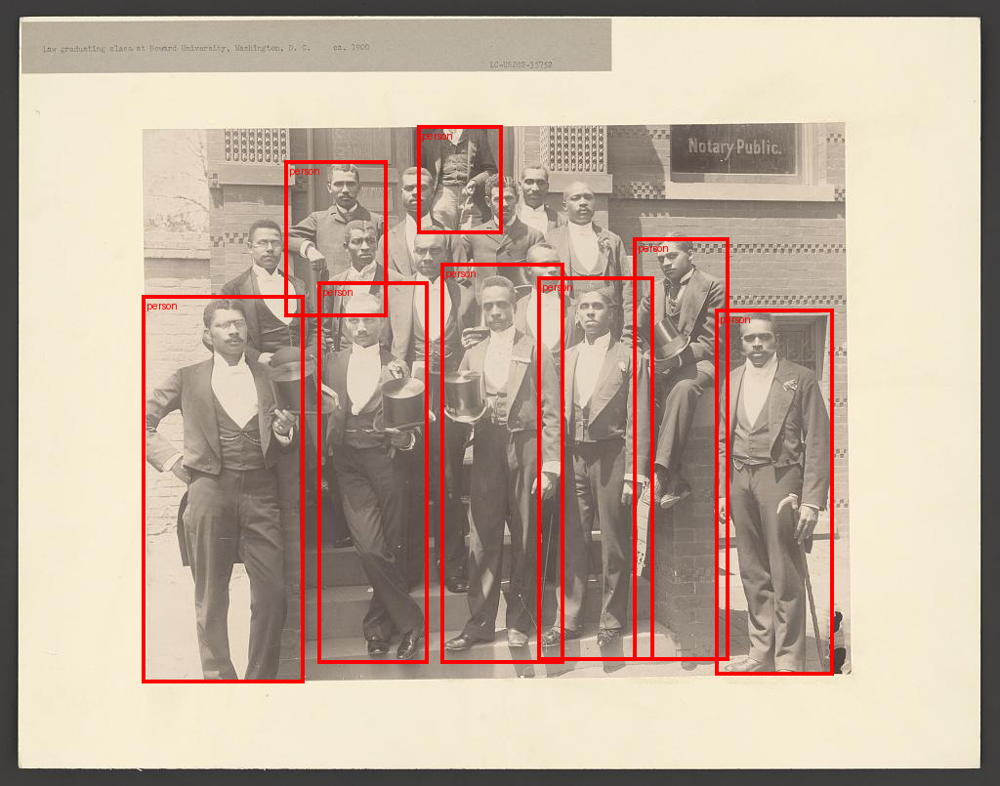

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


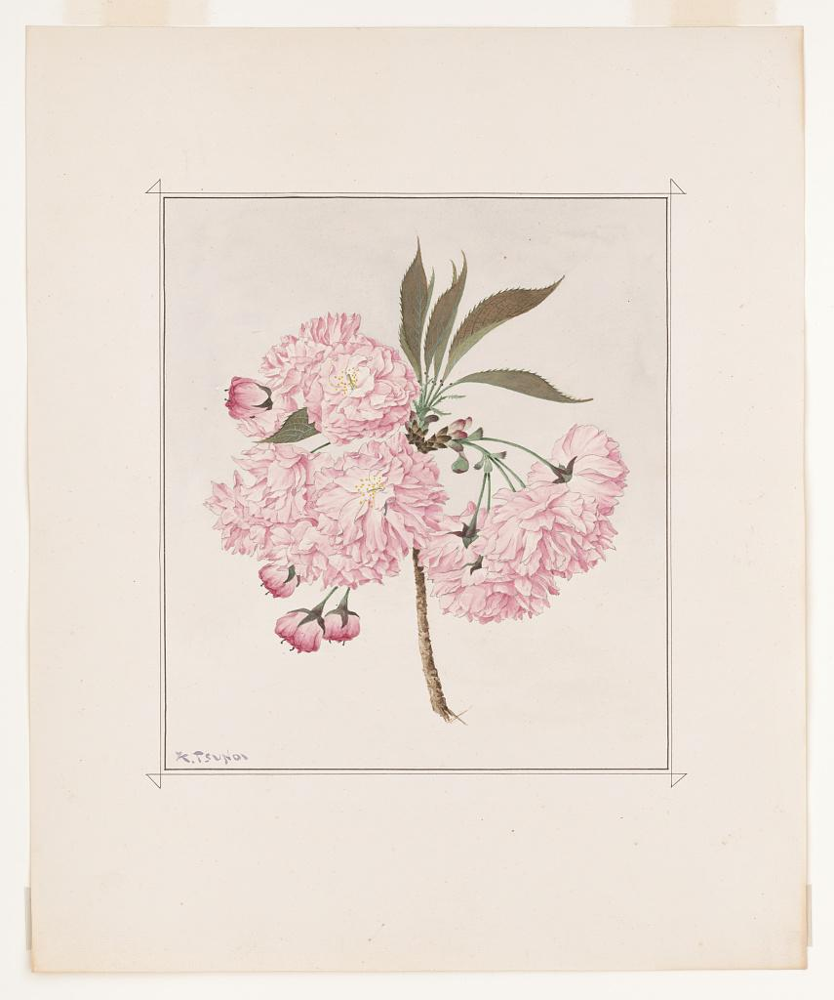

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


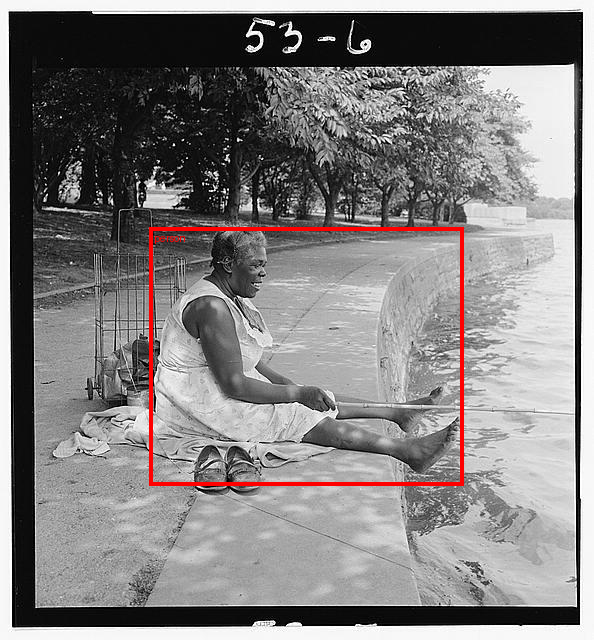

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


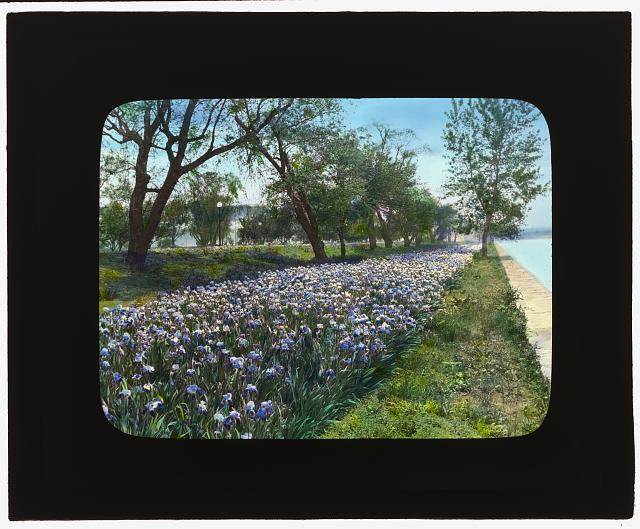

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


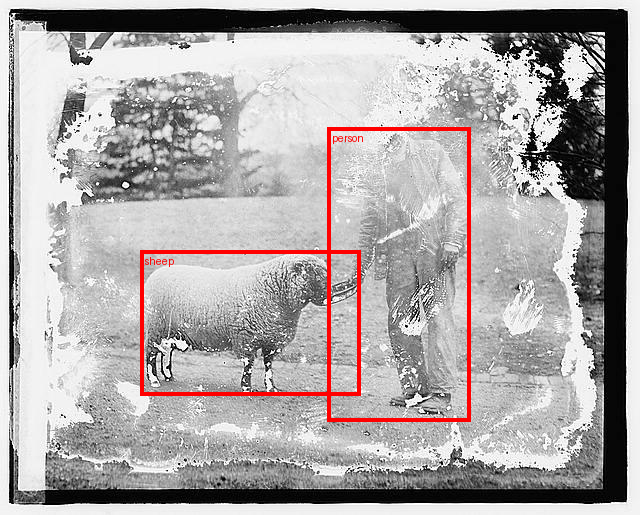

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


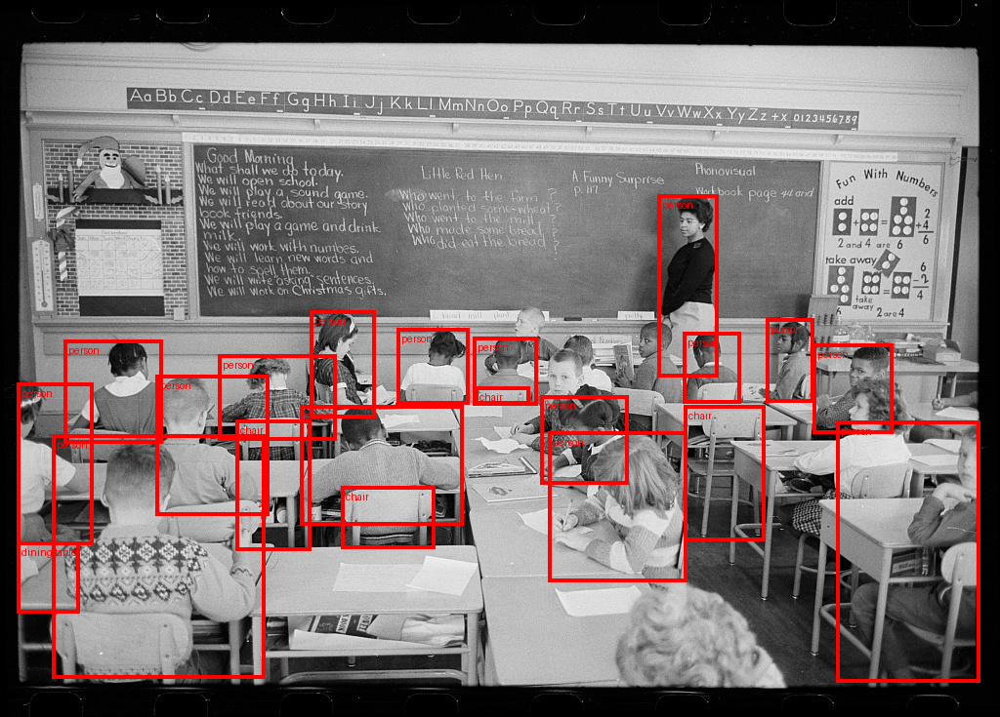

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


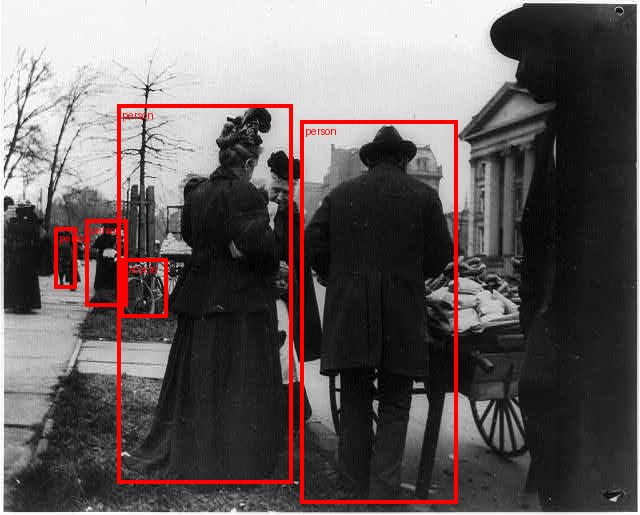

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


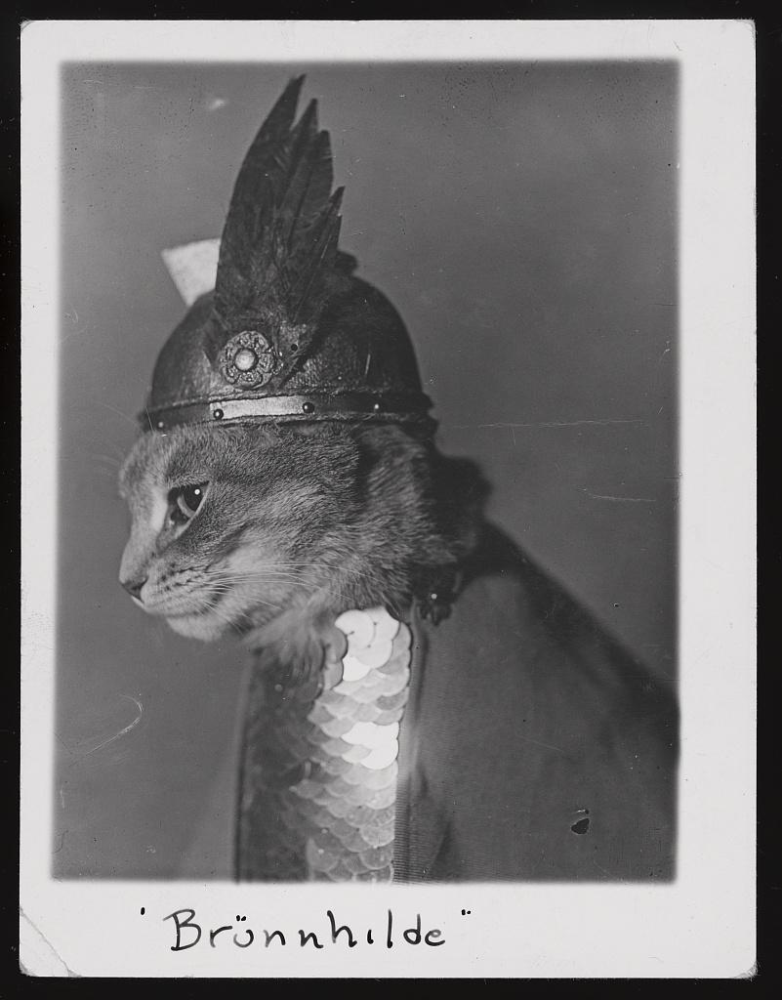

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


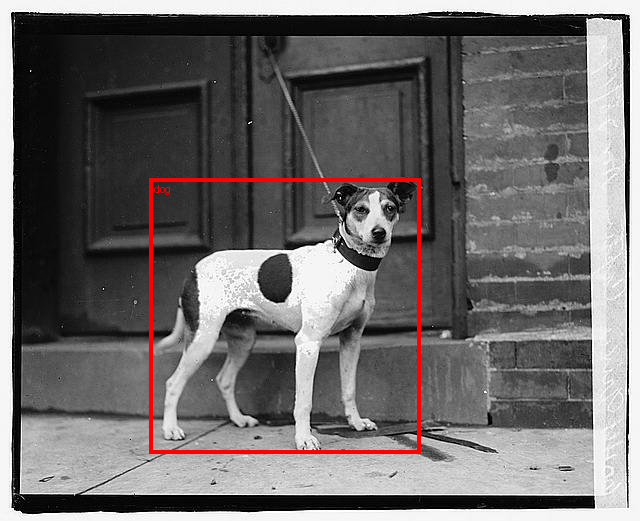

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


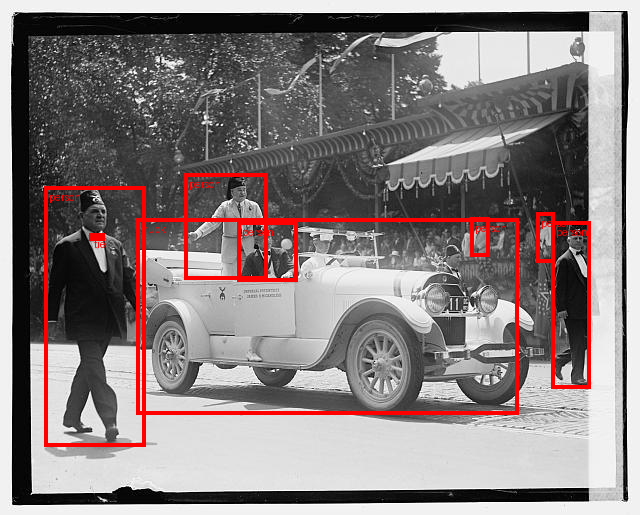

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


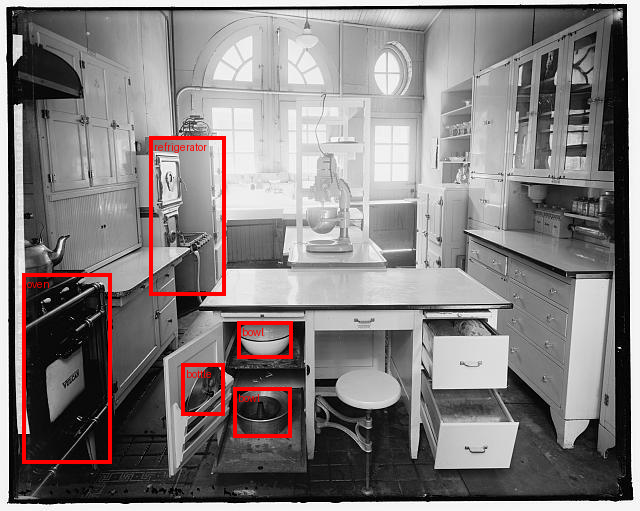

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


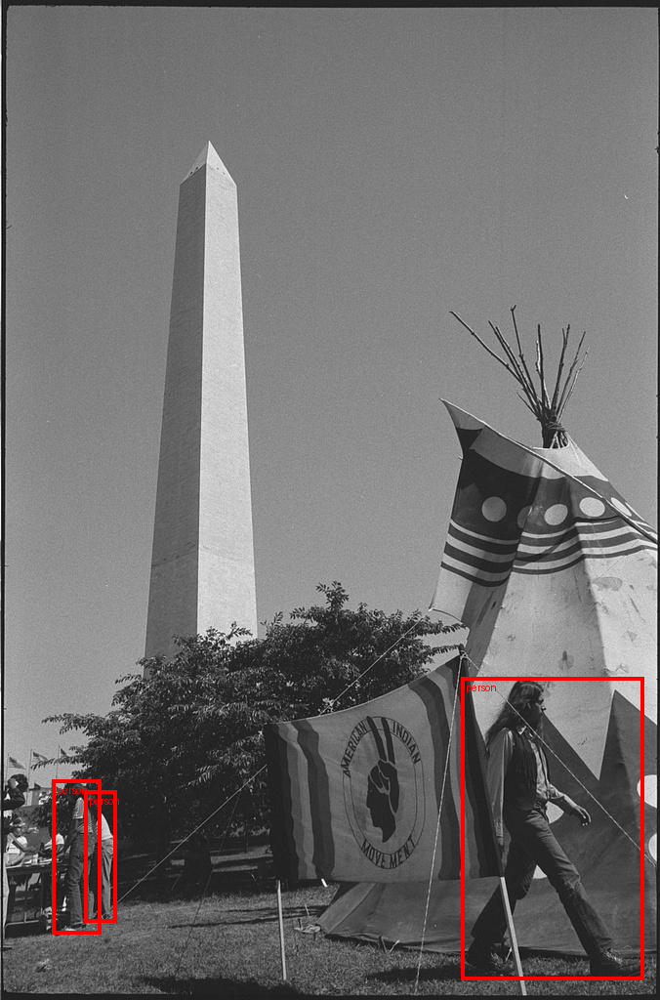

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


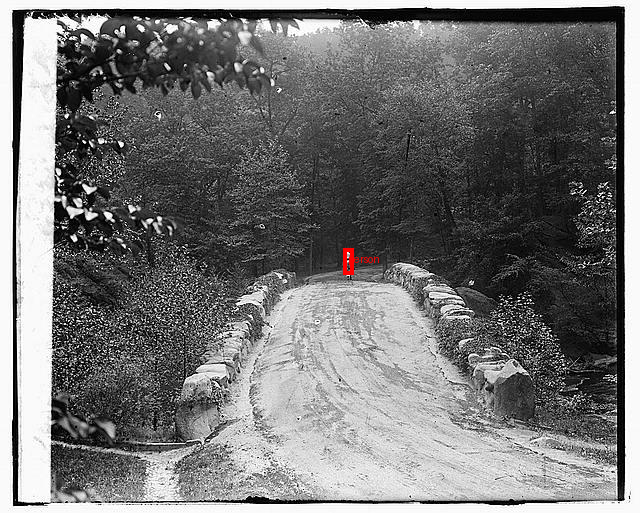

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


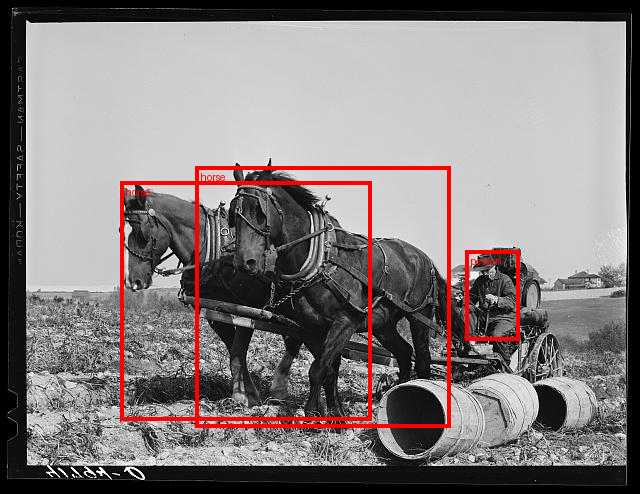

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


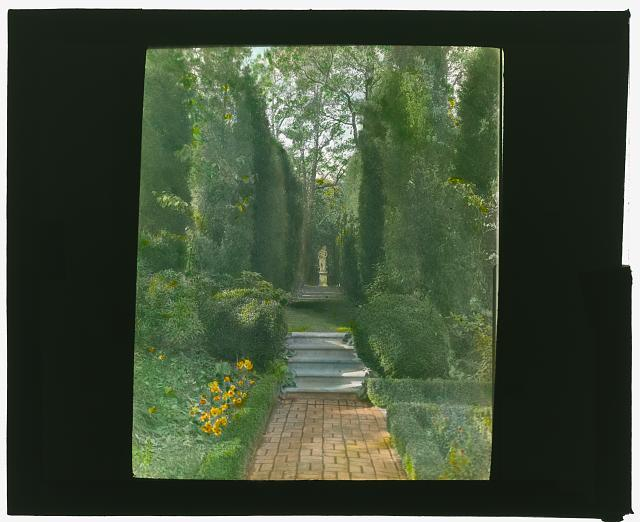

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


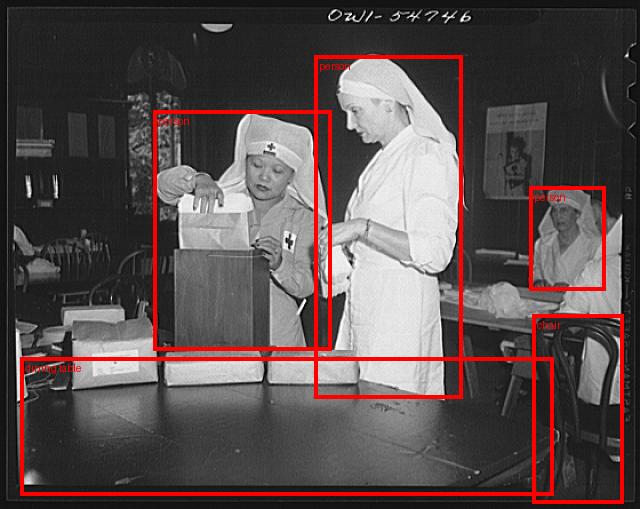

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


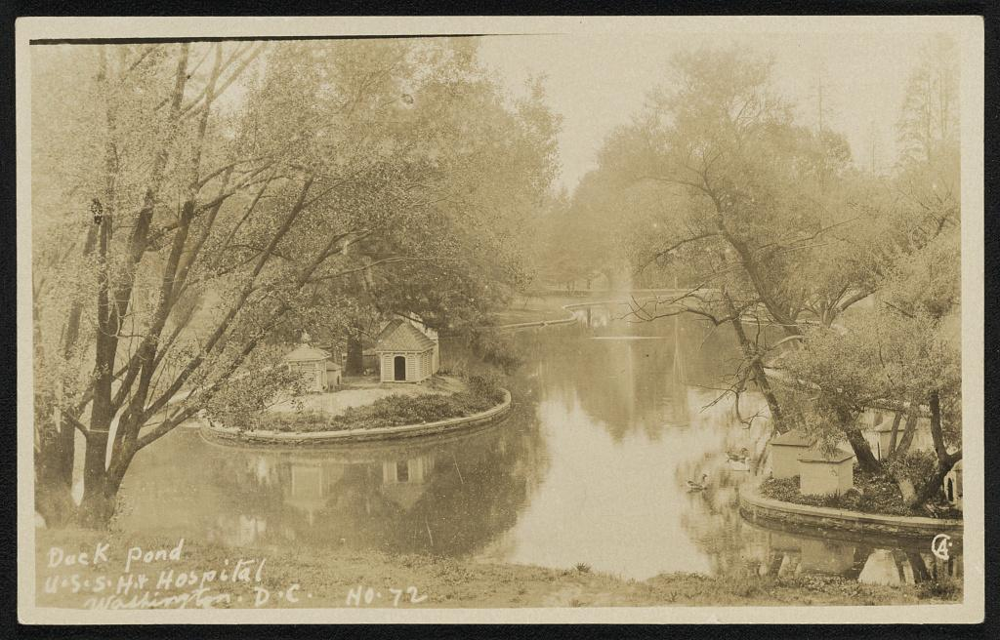

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


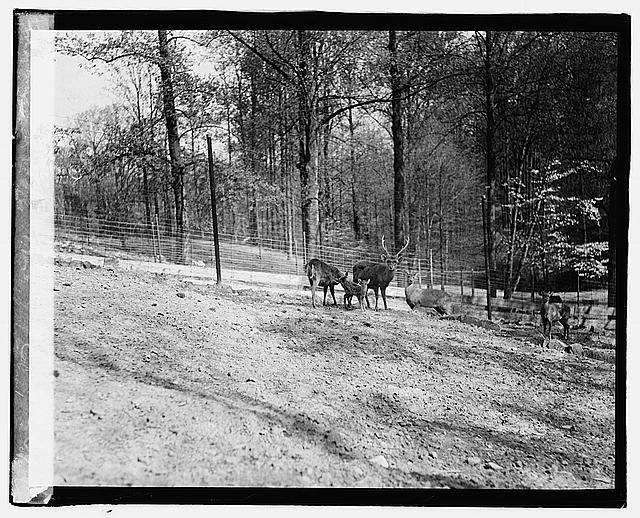

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


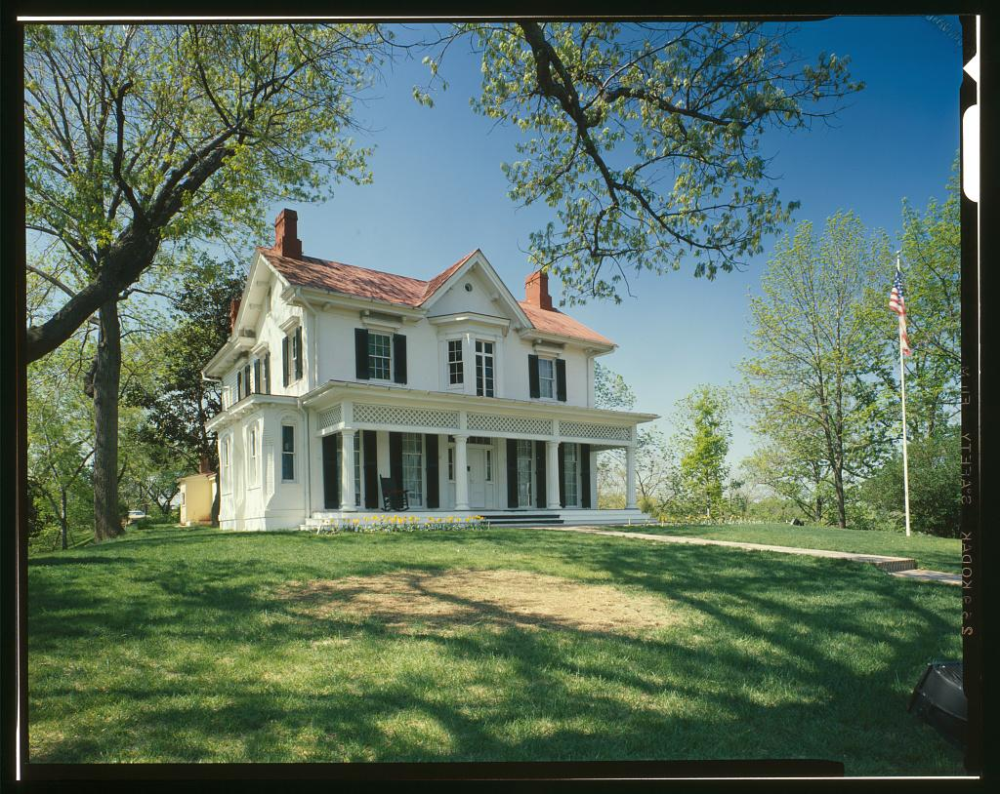

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


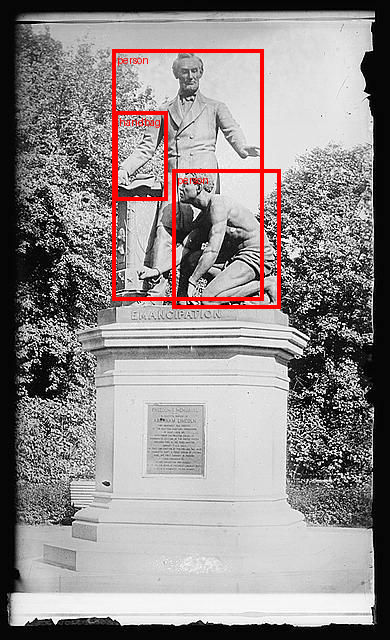

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


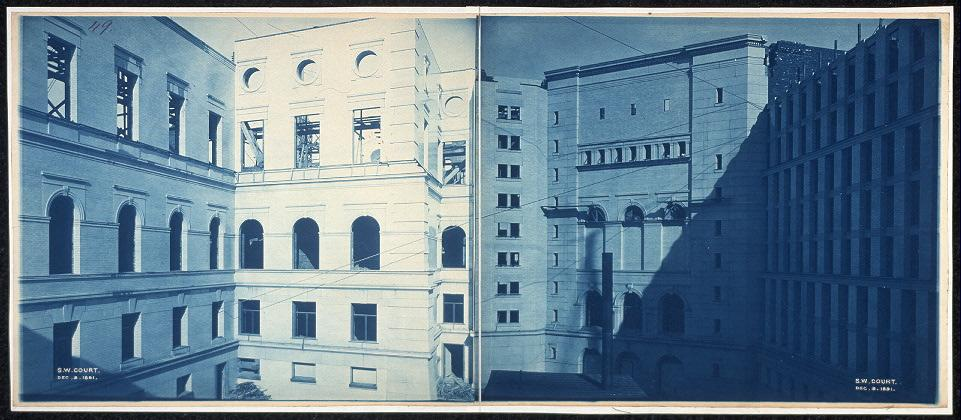

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


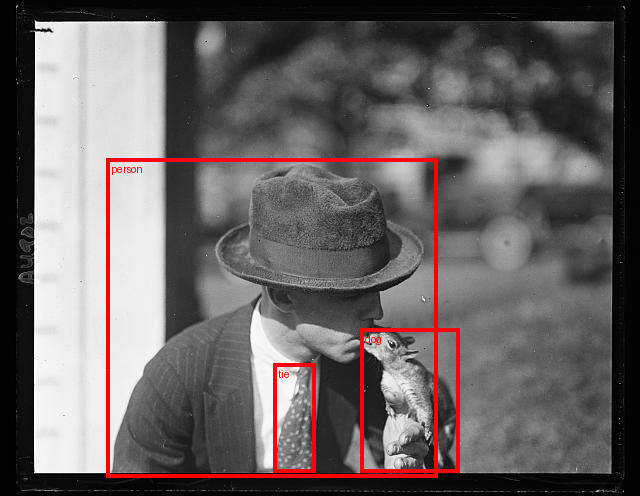

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:210: UserWarning: boxes doesn't contain any box. No box was drawn
  warnings.warn("boxes doesn't contain any box. No box was drawn")


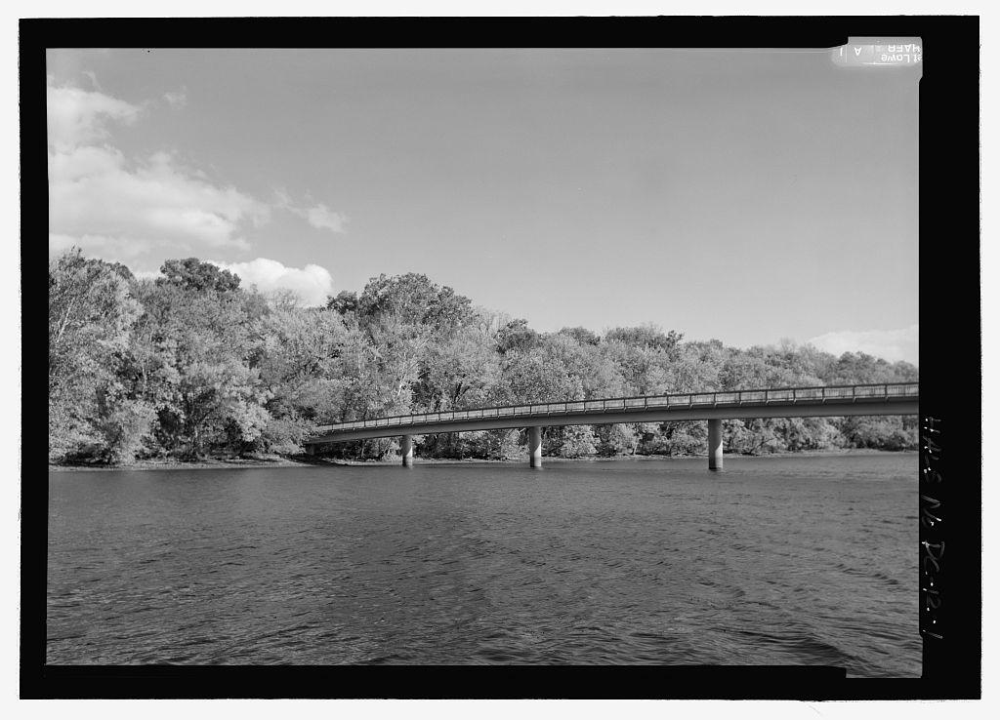

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


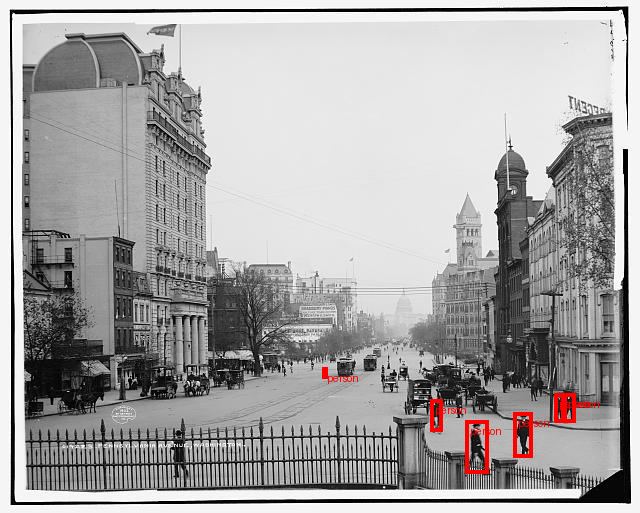

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


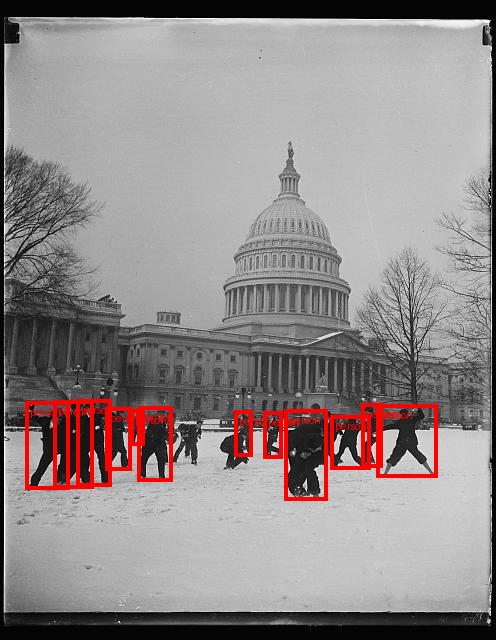

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


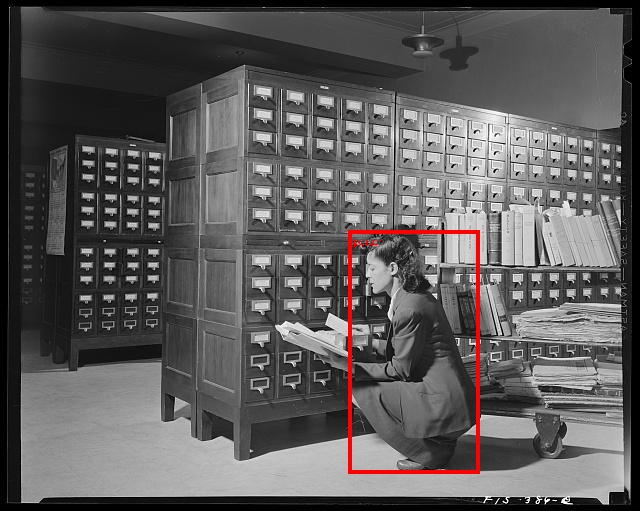

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


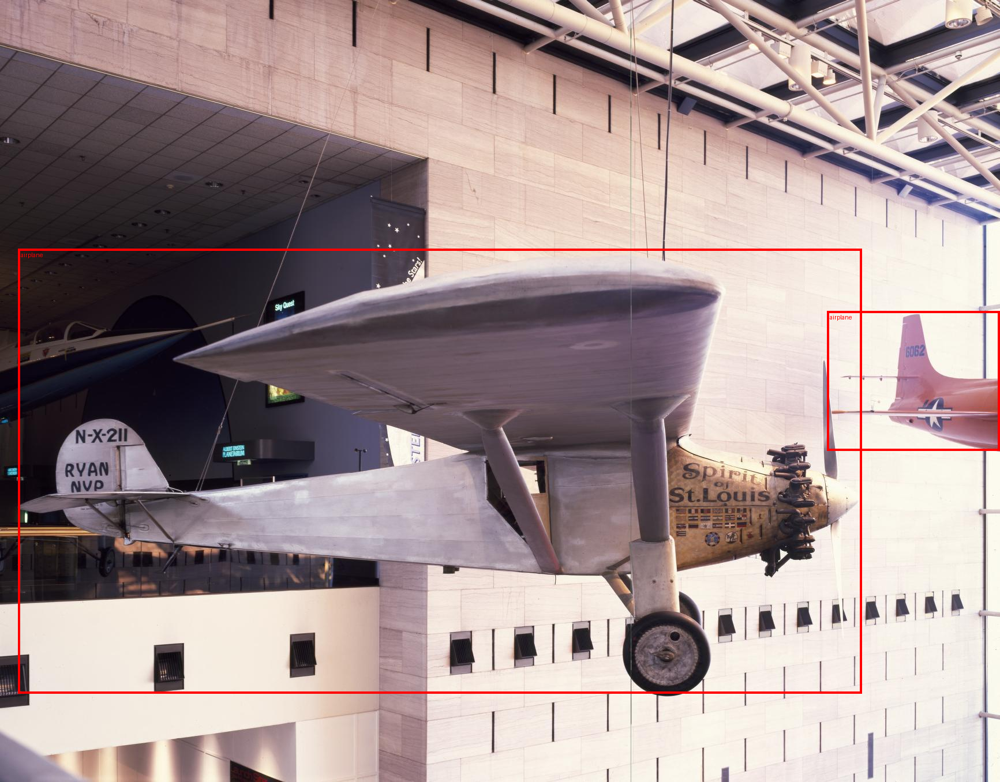

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


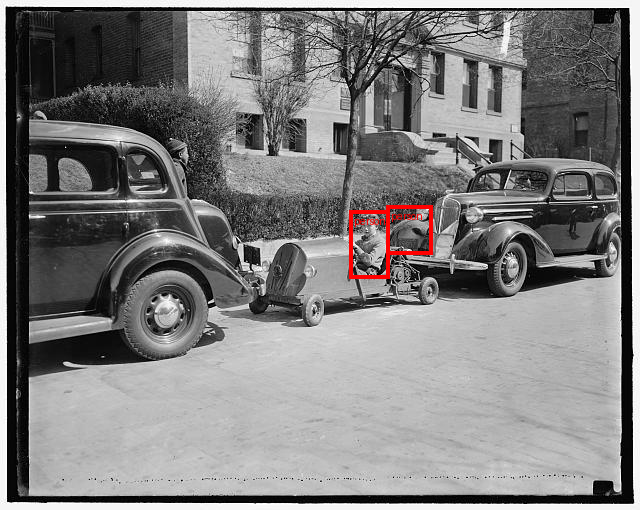

/Users/shauna-kayharrison/Desktop/loclab-jfp24/.venv/lib/python3.12/site-packages/torchvision/utils.py:224: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


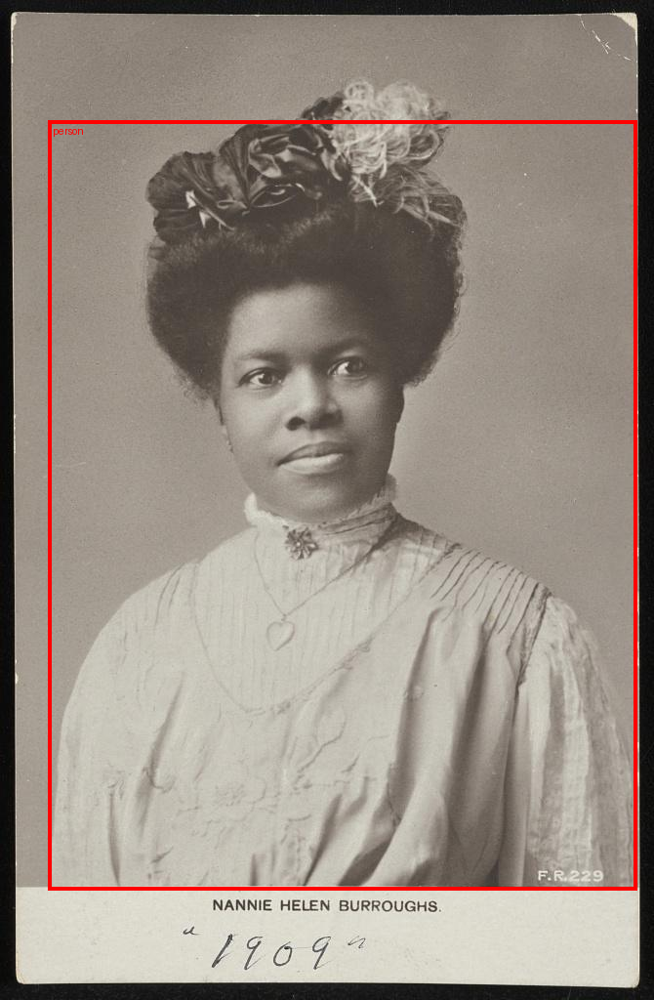

In [58]:
"""Iterate through directory and run model code on images"""
image_dir = './faster-rcnn-test-images'

for image in os.listdir(image_dir):
    f = os.path.join(image_dir, image)
    if os.path.isfile(f):
        if '.DS' not in f:
        # print(f)
            x = read_image(f)
            weights = FasterRCNN_ResNet50_FPN_V2_Weights.DEFAULT
            model = fasterrcnn_resnet50_fpn_v2(weights=weights, box_score_thresh=0.9)
            model.eval()

# # Step 2: Initialize the inference transforms
            preprocess = weights.transforms()

# # Step 3: Apply inference preprocessing transforms
            batch = [preprocess(x)]

# # Step 4: Use the model and visualize the prediction
            prediction = model(batch)[0]
            labels = [weights.meta["categories"][i] for i in prediction["labels"]]
            box = draw_bounding_boxes(
            x, boxes=prediction["boxes"], labels=labels, colors="red", width=4, font_size=30
        )
            im = to_pil_image(box.detach())
            im.show()

# # Displays the Image
            display(im)
    # except:
    #     print('error')